In [1]:
import matplotlib.pyplot as plt 
import seaborn as sns 
import pandas as pd
import numpy as np

In [2]:
#data = pd.read_csv('../USGS_transformed2.csv')
data = pd.read_parquet('../USGS_transformed2.parquet', engine='pyarrow')
pd.set_option('display.max_columns', None)
data.head()


,id,mag,place,time,updated,felt,cdi,mmi,status,tsunami,sig,net,code,ids,sources,types,nst,dmin,rms,gap,magType,type,lon,lat,depth,dist
0,nc71338046,1.02,"8 km W of Cobb, California",2010-01-09 23:59:49.050,2017-01-21 17:53:01.190,NaN,NaN,NaN,reviewed,0,16,nc,71338046,",nc71338046,",",nc,",",focal-mechanism,nearby-cities,origin,phase-data,",30.0,0.009910,0.0800,47.00,md,earthquake,-122.820333,38.816333,10.0,8
1,nn00301678,1.30,"64 km ESE of Goldfield, Nevada",2010-01-09 23:50:50.837,2018-06-13 20:51:35.942,NaN,NaN,NaN,reviewed,0,26,nn,00301678,",nn00301678,",",nn,",",origin,phase-data,",20.0,0.154000,0.1138,114.57,ml,earthquake,-116.561300,37.493500,11.7,64
2,nc71338036,0.57,"6 km WNW of Cobb, California",2010-01-09 23:43:09.630,2017-01-21 17:52:51.979,NaN,NaN,NaN,automatic,0,5,nc,71338036,",nc71338036,",",nc,",",nearby-cities,origin,phase-data,",8.0,0.009009,0.1300,99.00,md,earthquake,-122.791832,38.847332,10.0,6
3,nc71338031,0.46,"5 km SW of Cobb, California",2010-01-09 23:41:16.030,2017-01-21 17:52:47.427,NaN,NaN,NaN,reviewed,0,3,nc,71338031,",nc71338031,",",nc,",",nearby-cities,origin,phase-data,",5.0,0.013510,0.0200,138.00,md,earthquake,-122.767500,38.788333,10.0,5
4,uu50393750,1.20,"10 km SSE of Cedar City, Utah",2010-01-09 23:37:09.400,2018-08-29 00:29:58.580,NaN,NaN,NaN,reviewed,0,22,uu,50393750,",uu50393750,",",uu,",",origin,phase-data,",8.0,0.139200,0.1400,76.00,md,earthquake,-113.037167,37.589000,10.0,10


In [3]:
dataml = data[['mag', 'tsunami', 'type', 'depth', 'dist']]
dataml.dropna(inplace=True)
d = dataml.copy()

/var/folders/9y/hwhn13gx33x0n3fjt7f9k0y00000gn/T/ipykernel_13742/1251922408.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dataml.dropna(inplace=True)


In [4]:
dataml = data[['mag', 'tsunami', 'type', 'depth', 'dist']]

In [5]:
dataml.shape

(1857134, 5)

In [6]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
# from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_samples, silhouette_score
import joblib

In [7]:
numeric_features = ['mag', 'tsunami', 'depth', 'dist']
numeric_transformer = StandardScaler()

categorical_features = ['type']
categorical_transformer = OneHotEncoder(drop='first', sparse = False)

preprocessor = ColumnTransformer(
    transformers=[
        ("num", numeric_transformer, numeric_features),
        ("cat", categorical_transformer, categorical_features),
    ]
)

In [8]:

clus = 4

preprocessor.fit(d)
joblib.dump(preprocessor, 'pre.pkl', compress=1)
km = KMeans(n_clusters=clus, random_state=0)
x = km.fit(preprocessor.transform(d))
joblib.dump(km, 'km'+str(clus)+'.pkl', compress=1)


etiquetas = km.labels_


In [9]:
#filter the 2 without values
data = data[data['depth'].notnull()]

In [10]:
# add the column with the cluster to main dataset
data['clusters'] = etiquetas

In [11]:
#check that 'cluster colum was added ok'
data.head(1)

,id,mag,place,time,updated,felt,cdi,mmi,status,tsunami,sig,net,code,ids,sources,types,nst,dmin,rms,gap,magType,type,lon,lat,depth,dist,clusters
0,nc71338046,1.02,"8 km W of Cobb, California",2010-01-09 23:59:49.050,2017-01-21 17:53:01.190,NaN,NaN,NaN,reviewed,0,16,nc,71338046,",nc71338046,",",nc,",",focal-mechanism,nearby-cities,origin,phase-data,",30.0,0.00991,0.08,47.0,md,earthquake,-122.820333,38.816333,10.0,8,0


In [55]:
#hacemos una funcion que cree mapa de calor segun la correlacion
def plot_corre_heatmap(corr):
    '''
    
    '''
    plt.figure(figsize=(12,10))
    sns.heatmap(corr, cbar = True,  square = False, annot=True, fmt= '.2f'
                ,annot_kws={'size': 10},cmap= 'coolwarm')
    plt.xticks(rotation = 45)
    plt.yticks(rotation = 45)
    # Arreglamos un pequeño problema de visualización
    b, t = plt.ylim() # discover the values for bottom and top
    b += 0.5 # Add 0.5 to the bottom
    t -= 0.5 # Subtract 0.5 from the top
    plt.ylim(b, t) # update the ylim(bottom, top) values
    plt.show()

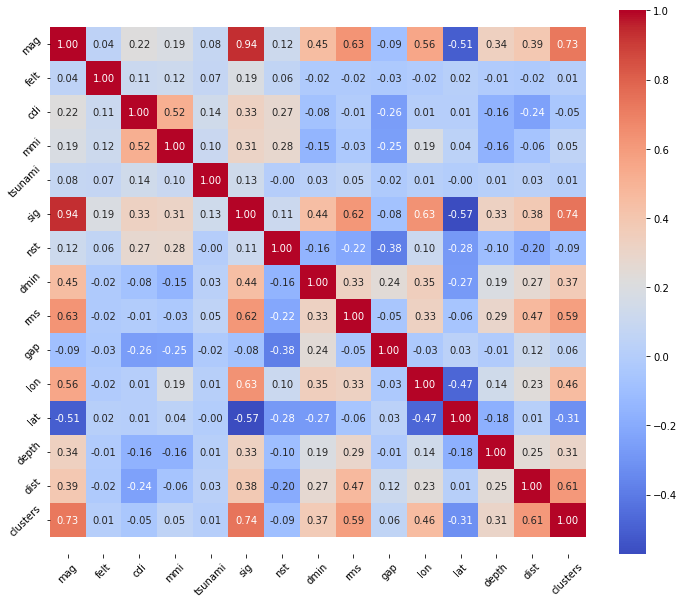

In [56]:
corr = data.corr()
plot_corre_heatmap(corr)

In [ ]:
'''
sns.scatterplot(data=data, x="mag", y="clusters", hue=etiquetas)
plt.scatter(km.cluster_centers_[:,0], km.cluster_centers_[:,1], 
            marker="X", c="r", s=80, label="centroids")
plt.legend()
plt.show()
'''

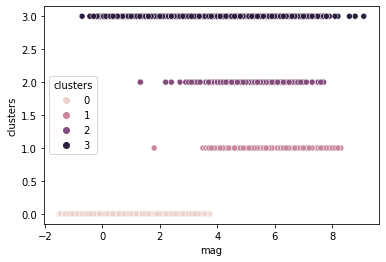

In [14]:
sns.scatterplot(data=data, x="mag", y="clusters", hue="clusters")
plt.show()

In [57]:
mag = data[['mag', 'clusters']]

In [59]:
mag.value_counts()

mag   clusters
1.10  0           48656
1.30  0           44595
1.40  0           44208
1.20  0           42958
1.00  0           38173
                  ...  
4.35  1               1
4.42  1               1
4.46  1               1
4.47  1               1
9.10  3               1
Length: 1417, dtype: int64

In [17]:
data.groupby(['clusters']).agg(pd.Series.mode).iloc[:, [1, 9, 21, 24, 25] ]

,mag,tsunami,type,depth,dist
clusters,,,,,
0,1.1,0,earthquake,10.0,6
1,"[4.1, 4.3]",1,earthquake,10.0,16
2,4.3,0,earthquake,300.0,16
3,4.4,0,earthquake,10.0,16


In [35]:
data.groupby('clusters').agg({'mag': ['mean', 'min', 'max'], 'dist': ['mean', 'min', 'max'], 'depth': ['mean', 'min', 'max']})

mag                    dist                depth               
              mean   min   max        mean min  max        mean    min     max
clusters                                                                      
0         1.177734 -1.50  3.74   19.969676   0  157   16.968820   10.0  245.30
1         5.287430  1.80  8.30   77.208499   0  295   46.668096   10.0  670.81
2         4.410954  1.32  7.70  110.472938   0  299  498.043549  258.4  697.36
3         3.476300 -0.71  9.10   86.201495   0  418   46.333476   10.0  278.40

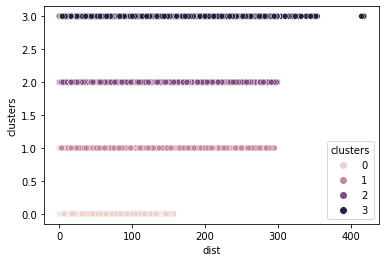

In [18]:
sns.scatterplot(data=data, x="dist", y="clusters", hue="clusters")
plt.show()

In [ ]:
#The distance seems to not be a major features for our model

In [41]:
tsunami = data[['tsunami', 'clusters']]

In [42]:
tsunami.value_counts()

tsunami  clusters
0        0           1496233
         3            345776
         2             13617
1        1              1506
dtype: int64

In [19]:
data['tsunami'].value_counts()

0    1855626
1       1506
Name: tsunami, dtype: int64

In [20]:
#Cluster 1 = tsunami zone
data['clusters'].value_counts()

0    1496233
3     345776
2      13617
1       1506
Name: clusters, dtype: int64

In [28]:
tsunamis_data = data[['tsunami', 'clusters', 'lat', 'lon']]

In [29]:
tsunami_ml = tsunamis_data[tsunamis_data['tsunami'] == 1]

In [31]:
#pip install folium
import folium

mapa=folium.Map(location=[-35.675147, -71.542969],zoom_start=1)

In [32]:
distritos=tsunami_ml[ ['lat','lon'] ].to_numpy()

In [34]:
#show tsunami region 
from folium.plugins import HeatMap

HeatMap(distritos, radius=2, max_val=0.2, min_opacity=0.9).add_to(mapa)
mapa

/var/folders/9y/hwhn13gx33x0n3fjt7f9k0y00000gn/T/ipykernel_13742/723518468.py:3: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(distritos, radius=3, max_val=0.2, min_opacity=0.9).add_to(mapa)


In [19]:
data.groupby('clusters').median()

,mag,felt,cdi,mmi,tsunami,sig,nst,dmin,rms,gap,lon,lat,depth,dist
clusters,,,,,,,,,,,,,,
0,1.11,2.0,2.2,3.6100,0.0,19.0,10.0,0.0587,0.14,110.0,-121.15650,38.6822,10.0,13.0
1,5.10,18.0,3.8,4.2330,1.0,437.0,1.0,0.1540,0.82,98.0,-130.38125,51.2375,20.0,53.0
2,4.30,0.0,1.0,1.9555,0.0,284.0,1.0,0.1540,0.75,100.0,-177.72150,-18.2902,526.5,16.0
3,4.00,1.0,1.0,3.9000,0.0,246.0,1.0,0.0587,0.63,110.0,-92.30100,37.0890,25.3,74.0


In [25]:
data['type'].unique()

array(['earthquake', 'explosion', 'quarry', 'ice quake', 'other event',
       'building other event', 'volcanic eruption'], dtype=object)

In [27]:
volcanic = data[data['type']=='volcanic eruption']

In [28]:
# Almost all volcanic type are part of cluster 3
volcanic['clusters'].value_counts()

3    62
1     1
Name: clusters, dtype: int64

In [32]:
data[(data['clusters'] == 3) & (data['type']!='volcanic eruption')]

,id,mag,place,time,updated,felt,cdi,mmi,status,tsunami,sig,net,code,ids,sources,types,nst,dmin,rms,gap,magType,type,lon,lat,depth,dist,clusters
22,ak010f8o919,2.3,"59 km WNW of Anchor Point, Alaska",2010-01-09 21:56:10.216,2018-07-06 19:46:52.226,NaN,NaN,NaN,reviewed,0,81,ak,010f8o919,",ak010f8o919,",",ak,",",origin,phase-data,",1.0,0.0587,0.47,110.0,ml,earthquake,-152.7981,59.9936,107.7,59,3
31,rusms00004807,3.2,"34 km NE of Edgerton, Wyoming",2010-01-09 21:03:37.520,2022-06-09 21:13:21.435,NaN,NaN,NaN,reviewed,0,158,rusms,00004807,",rusms00004807,",",rusms,",",impact-text,origin,phase-data,",19.0,0.0587,1.38,100.1,ml,explosion,-106.0030,43.6630,10.0,34,3
32,rusms00004806,3.3,"31 km SSE of Sleepy Hollow, Wyoming",2010-01-09 20:59:48.900,2022-06-09 21:13:21.426,NaN,NaN,NaN,reviewed,0,168,rusms,00004806,",rusms00004806,",",rusms,",",impact-text,origin,phase-data,",23.0,0.0587,0.67,59.9,ml,explosion,-105.2350,43.9920,10.0,31,3
35,usp000h5wb,4.4,"79 km E of ?d?grat, Ethiopia",2010-01-09 20:34:39.910,2014-11-07 01:40:26.062,NaN,NaN,NaN,reviewed,0,298,us,p000h5wb,",usp000h5wb,",",us,",",impact-text,origin,phase-data,",29.0,0.0587,1.02,154.2,mb,earthquake,40.1880,14.1850,10.0,79,3
37,usp000h5wa,4.6,Southwest Indian Ridge,2010-01-09 20:25:27.070,2014-11-07 01:40:26.059,NaN,NaN,NaN,reviewed,0,326,us,p000h5wa,",usp000h5wa,",",us,",",impact-text,origin,phase-data,",20.0,0.0587,1.17,75.7,mb,earthquake,57.6220,-31.7770,10.0,16,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1857026,ak022dglq8fo,2.4,"173 km SE of Unalaska, Alaska",2022-10-20 02:12:51.060,2022-11-12 00:04:17.333,NaN,NaN,NaN,reviewed,0,89,ak,022dglq8fo,",ak022dglq8fo,",",ak,",",origin,phase-data,",1.0,0.0587,0.68,110.0,ml,earthquake,-164.9695,52.6287,25.9,173,3
1857039,ak022dgl9fbb,2.0,"83 km W of Karluk, Alaska",2022-10-20 01:34:08.923,2022-11-12 00:04:14.469,NaN,NaN,NaN,reviewed,0,62,ak,022dgl9fbb,",us6000iv10,ak022dgl9fbb,",",us,ak,",",origin,phase-data,",1.0,0.0587,0.62,110.0,ml,earthquake,-155.8396,57.6445,10.0,83,3
1857074,ak022dgkpret,2.4,"63 km E of Port Alsworth, Alaska",2022-10-20 00:42:36.216,2022-11-12 00:59:39.040,NaN,NaN,NaN,reviewed,0,89,ak,022dgkpret,",us6000iv0l,ak022dgkpret,",",us,ak,",",origin,phase-data,",1.0,0.0587,0.49,110.0,ml,earthquake,-153.1718,60.2125,140.7,63,3
1857077,us6000iwbq,4.8,"120 km ESE of Pangai, Tonga",2022-10-20 00:37:20.044,2022-11-11 23:36:46.040,NaN,NaN,NaN,reviewed,0,354,us,6000iwbq,",us6000iwbq,",",us,",",origin,phase-data,",35.0,0.1540,0.90,82.0,mb,earthquake,-173.2588,-20.1467,10.0,120,3


In [15]:
#pip install folium
import folium

mapa=folium.Map(location=[-35.675147, -71.542969],zoom_start=1)


In [17]:
distritos=data[ ['lat','lon'] ].to_numpy()

In [50]:
from folium.plugins import HeatMap

HeatMap(distritos, radius=5, max_val=0.2, min_opacity=0.7).add_to(mapa)
mapa

/var/folders/9y/hwhn13gx33x0n3fjt7f9k0y00000gn/T/ipykernel_9647/2883189653.py:3: UserWarning: The `max_val` parameter is no longer necessary. The largest intensity is calculated automatically.
  HeatMap(distritos, radius=10, max_val=0.1, min_opacity=0.5).add_to(mapa)
